<a href="https://colab.research.google.com/github/changsin/FSDL/blob/main/kaggle-license-plate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Car License Plate Detection from Kaggle
Here is a short run of car license plate detection using Kaggle dataset:
https://www.kaggle.com/andrewmvd/car-plate-detection

The model used is VGG16

In [1]:
%matplotlib inline

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import cv2
import os
import glob

# Load
First load and prepare the data

In [2]:
import os
for dirname, _, filenames in os.walk('./input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

In [3]:
IMAGE_SIZE = 224
DATA_ROOT = "./drive/MyDrive/data"

In [4]:
img_dir = DATA_ROOT + "/car-plate-detection/images" # Enter Directory of all images 
data_path = os.path.join(img_dir,'*g')
files = glob.glob(data_path)
files.sort() #We sort the images in alphabetical order to match them to the xml files containing the annotations of the bounding boxes
X=[]
for f1 in files:
    img = cv2.imread(f1)
    img = cv2.resize(img, (IMAGE_SIZE,IMAGE_SIZE))
    X.append(np.array(img))

In [5]:
from lxml import etree
def resizeannotation(f):
    tree = etree.parse(f)
    for dim in tree.xpath("size"):
        width = int(dim.xpath("width")[0].text)
        height = int(dim.xpath("height")[0].text)
    for dim in tree.xpath("object/bndbox"):
        xmin = int(dim.xpath("xmin")[0].text)/(width/IMAGE_SIZE)
        ymin = int(dim.xpath("ymin")[0].text)/(height/IMAGE_SIZE)
        xmax = int(dim.xpath("xmax")[0].text)/(width/IMAGE_SIZE)
        ymax = int(dim.xpath("ymax")[0].text)/(height/IMAGE_SIZE)
    return [int(xmax), int(ymax), int(xmin), int(ymin)]
        

In [6]:
path = DATA_ROOT + '/car-plate-detection/annotations'
text_files = [DATA_ROOT + '/car-plate-detection/annotations/'+f for f in sorted(os.listdir(path))]
y=[]
for i in text_files:
    y.append(resizeannotation(i))

In [7]:
resizeannotation(DATA_ROOT + "/car-plate-detection/annotations/Cars147.xml")

[188, 141, 101, 104]

In [8]:
y[0]

[187, 144, 101, 104]

In [9]:
np.array(X).shape

(433, 224, 224, 3)

In [10]:
np.array(y).shape

(433, 4)

Display the first 18 images

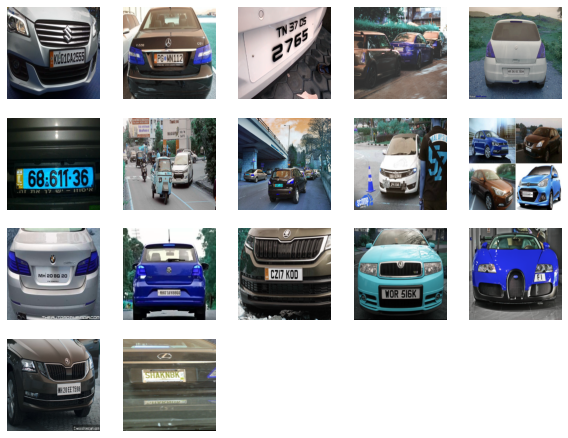

In [11]:
plt.figure(figsize=(10,20))
for i in range(0,17) :
    plt.subplot(10,5,i+1)
    plt.axis('off')
    plt.imshow(X[i])

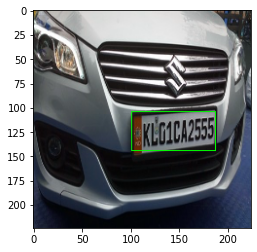

In [12]:
#Example with the first image of the dataset
image = cv2.rectangle(X[0],(y[0][0],y[0][1]),(y[0][2],y[0][3]),(0, 255, 0))
plt.imshow(image)
plt.show()

In [13]:
#Transforming in array
X=np.array(X)
y=np.array(y)

In [14]:
X[0].shape

(224, 224, 3)

In [15]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=1)

# Train

Use VGG16 to train. VGG16 is a CNN variety.

In [16]:
from keras.models import Sequential

from keras.layers import Dense, Flatten

from keras.applications.vgg16 import VGG16

## Transfer Learning

Use VGG16's pretrained weights and biaese.

In [17]:
# Create the model
model = Sequential()
model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))
model.add(Flatten())
model.add(Dense(128, activation="relu"))
model.add(Dense(128, activation="relu"))
model.add(Dense(64, activation="relu"))
model.add(Dense(4, activation="sigmoid"))

model.layers[-6].trainable = False

model.summary()

58892288/58889256 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten (Flatten)            (None, 25088)             0         
_________________________________________________________________
dense (Dense)                (None, 128)               3211392   
_________________________________________________________________
dense_1 (Dense)              (None, 128)               16512     
_________________________________________________________________
dense_2 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_3 (Dense)              (None, 4)                 260       
Total params: 17,951,108
Trainable params: 3,236,420
Non-

In [18]:
model.layers

In [19]:
model.compile(loss='mean_squared_error', optimizer='adam', metrics=['accuracy'])

In [20]:
import datetime
import tensorflow as tf

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [21]:
# train = model.fit(X_train, y_train,
#                   validation_data=(X_val, y_val),
#                   epochs=50, batch_size=32, verbose=1)


train = model.fit(x=X_train, y=y_train,
                  validation_data=(X_val, y_val),
                  epochs=50, batch_size=32,
                  callbacks=[tensorboard_callback])

Epoch 1/50
10/10 [==============================] - 22s 393ms/step - loss: 17512.7470 - accuracy: 0.3524 - val_loss: 17675.7715 - val_accuracy: 0.5429
Epoch 2/50
10/10 [==============================] - 0s 50ms/step - loss: 17394.9496 - accuracy: 0.4248 - val_loss: 17675.7715 - val_accuracy: 0.5429
Epoch 3/50
10/10 [==============================] - 0s 48ms/step - loss: 17718.0073 - accuracy: 0.4200 - val_loss: 17675.7715 - val_accuracy: 0.5429
Epoch 4/50
10/10 [==============================] - 0s 49ms/step - loss: 17746.1467 - accuracy: 0.4339 - val_loss: 17675.7715 - val_accuracy: 0.5429
Epoch 5/50
10/10 [==============================] - 0s 47ms/step - loss: 17516.9512 - accuracy: 0.4397 - val_loss: 17675.7715 - val_accuracy: 0.5429
Epoch 6/50
10/10 [==============================] - 0s 47ms/step - loss: 17848.9260 - accuracy: 0.3981 - val_loss: 17675.7715 - val_accuracy: 0.5429
Epoch 7/50
10/10 [==============================] - 0s 49ms/step - loss: 17640.4762 - accuracy: 0.4580 -

In [22]:
%load_ext tensorboard
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [23]:
def plot_scores(train) :
    accuracy = train.history['accuracy']
    val_accuracy = train.history['val_accuracy']
    epochs = range(len(accuracy))
    plt.plot(epochs, accuracy, 'b', label='Score apprentissage')
    plt.plot(epochs, val_accuracy, 'r', label='Score validation')
    plt.title('Scores')
    plt.legend()
    plt.show()

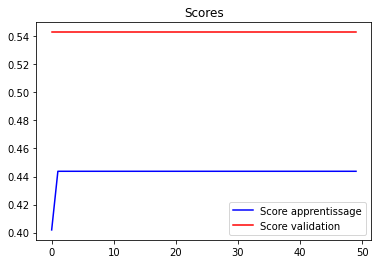

In [24]:
plot_scores(train)

In [25]:
test_loss, test_accuracy = model.evaluate(X_test, y_test,steps=int(100))

print("Test results \n Loss:",test_loss,'\n Accuracy',test_accuracy)


100/100 [==============================] - 1s 4ms/step - loss: 18657.3359 - accuracy: 0.4943
Test results 
 Loss: 18657.3359375 
 Accuracy 0.49425286054611206


In [26]:
 y_cnn = model.predict(X_test)

In [27]:
X_test.shape

(87, 224, 224, 3)

In [28]:
y_cnn[0].shape

(4,)

In [29]:
y_cnn.shape

(87, 4)

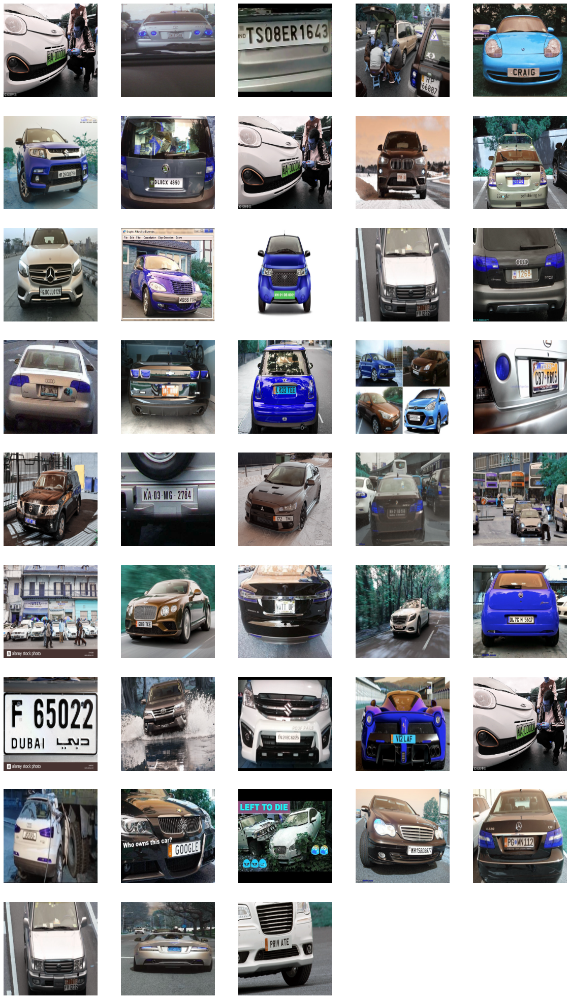

In [30]:
plt.figure(figsize=(20,40))
for i in range(0,43) :
    plt.subplot(10,5,i+1)
    plt.axis('off')
    ny = y_cnn[i]*255
    image = cv2.rectangle(X_test[i],(int(ny[0]),int(ny[1])),(int(ny[2]),int(ny[3])),(255, 0, 0))
    plt.imshow(image)